#  AIRBNB Capstone Project - Reviews.csv Cleaning/processing/munging

###  This Jupyter notebook is for cleaning and processing the reviews. some EDA following the Vader sentiment analysis is also carried out

1. The data is imported from reviews.csv
2. some initial cleaning and plotting of the review dates is carried out to see if there is any significant time trend.
3. the language of each review is detirmined using langdetect.
4. not english reviews are dropped as Vader only works on english language.
5. Vader sentiment analysis is carried out on the reviews. 
6. EDA to visualise the sentiment trends
7. The reviews are vectorized using TFidf to determine significant words.


In [1]:
import warnings
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import re
from dateutil.relativedelta import relativedelta
import twitter
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

import cufflinks as cf

import plotly.plotly as py
import plotly.tools as tls
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode(connected=False)
cf.go_offline()

sns.set(font_scale=1.5)
plt.style.use('fivethirtyeight')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

warnings.simplefilter('ignore')
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 10000)


In [2]:
#Unpack the required csv files from the zip
from shutil import unpack_archive
unpack_archive('../Capstone_DATA/Berlin/BERLIN_LISTINGS_AND_REVIEWS.zip', '../Capstone_DATA/Berlin/')

In [3]:
reviews = pd.read_csv('../Capstone_DATA/Berlin/reviews.csv')

In [4]:
#delete the csv files now they are stored in memory
!rm ./Capstone_DATA/Berlin/listings.csv
!rm ./Capstone_DATA/Berlin/reviews.csv

rm: ./Capstone_DATA/Berlin/listings.csv: No such file or directory
rm: ./Capstone_DATA/Berlin/reviews.csv: No such file or directory


In [5]:
reviews['date']=pd.to_datetime(reviews.date)

In [6]:
reviews.dropna(inplace=True)

In [7]:
reviews=reviews[~reviews.comments.str.contains('The host canceled this reservation')]

In [8]:
reviews = reviews[~reviews.comments.str.contains('The reservation was canceled')]

In [9]:
reviews[:20]

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ..."
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden..."
5,2015,74690922,2016-05-16,39859815,Eil,"Jan ist super flexibel und gut zu erreichen, w..."
6,2015,76603178,2016-05-28,29323516,Laurent,"We had a very nice stay in Berlin, thanks to J..."
7,2015,77296201,2016-05-31,9025122,Rasmus,"Great location close to Mauerpark, Kastanienal..."
8,2015,77834906,2016-06-03,39244464,Sabine,"Perfekte Lage, perfekte Ausstattung, perfekter..."
9,2015,82322683,2016-06-27,73902920,Mag,"Apartment very well located, close to everythi..."


In [10]:
review_count = reviews.groupby('date').count()

In [11]:
reviews['length']=reviews.comments.str.split().str.len()
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...,88
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...,29
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...,47
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ...",10
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden...",53


In [12]:
 reviews.length.iplot(kind='hist', title='Review Length',xTitle='Length of Review',bins=100)

In [13]:
trace1 = go.Scatter(x=review_count.resample('W').mean()['id'].index,
                    y=review_count.resample('W').mean()['id'],
                    name='Weekly Mean')
trace2 = go.Scatter(x=review_count.resample('M').mean()['id'].index,
                    y=review_count.resample('M').mean()['id'],
                    name='Monthly Mean')
layout = go.Layout(
    title='Reviews Per Week',
    yaxis=dict(
        title='Number of Reviews'),

    xaxis=dict(
        title='Date'
    )
)

config = {'scrollZoom': False,
          'displayModeBar': False,
          'editable': False
          }
fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig, config=config)

In [14]:
reviews = reviews.sample(n=30000)

In [15]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length
10281,181160,8539780,2013-11-04,9321078,Anastasiya,"This is a lovely property, close to public tra...",66
23120,274798,1940794,2012-08-10,2626398,Ruth,I had a really great time there! The room is g...,77
387574,25117755,326944030,2018-09-23,74542725,Jason,"Convenient transportation,very nice host and a...",8
79838,1585456,7650626,2013-09-28,1233002,Hannes,The location is great like the host - Michael....,65
174514,7081785,37797068,2015-07-10,11893653,Michael,Nice small room in friendly and quiet neighbou...,37


In [16]:
#Vader does not work on non-english language, so I want to exclude these reviews for now.
#I need to calculate which reviews are in english. I will use langdetect from google to detirmine this
# https://github.com/Mimino666/langdetect for the package details

from langdetect import detect

def lang_detect(text):
    """fuction for error management due to error when no text is contained in the comment"""
    try:
        return detect(text)
    except:
        return 'na'

In [17]:
#Test out
print(lang_detect(np.nan))
print(lang_detect('hello there, nice coat'))
print(lang_detect('hola mi amigo, que pasa'))

na
en
es


In [18]:
#Trial run on small sample
reviews_sample=reviews[:10000]
%time reviews_sample['language']=reviews_sample.comments.apply(lang_detect)

reviews_sample.head()

CPU times: user 1min 3s, sys: 1.91 s, total: 1min 5s
Wall time: 1min 11s


,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language
10281,181160,8539780,2013-11-04,9321078,Anastasiya,"This is a lovely property, close to public tra...",66,en
23120,274798,1940794,2012-08-10,2626398,Ruth,I had a really great time there! The room is g...,77,en
387574,25117755,326944030,2018-09-23,74542725,Jason,"Convenient transportation,very nice host and a...",8,en
79838,1585456,7650626,2013-09-28,1233002,Hannes,The location is great like the host - Michael....,65,en
174514,7081785,37797068,2015-07-10,11893653,Michael,Nice small room in friendly and quiet neighbou...,37,en


In [19]:
#This will take some time...

In [20]:
%time reviews['language']=reviews.comments.apply(lang_detect)
reviews.head()

CPU times: user 2min 37s, sys: 5.02 s, total: 2min 42s
Wall time: 2min 52s


,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language
10281,181160,8539780,2013-11-04,9321078,Anastasiya,"This is a lovely property, close to public tra...",66,en
23120,274798,1940794,2012-08-10,2626398,Ruth,I had a really great time there! The room is g...,77,en
387574,25117755,326944030,2018-09-23,74542725,Jason,"Convenient transportation,very nice host and a...",8,en
79838,1585456,7650626,2013-09-28,1233002,Hannes,The location is great like the host - Michael....,65,en
174514,7081785,37797068,2015-07-10,11893653,Michael,Nice small room in friendly and quiet neighbou...,37,en


In [21]:
#how many reviews from each language
reviews.language.value_counts()

en       20099
de        5923
fr        1284
es         913
it         372
nl         255
ru         188
ko         124
pt         113
da         110
zh-cn       83
na          50
ca          49
pl          44
ro          44
no          44
sv          40
af          39
cs          38
fi          31
so          30
ja          21
el          18
hu          15
id          11
tr          10
tl           8
vi           7
sk           6
hr           5
cy           5
et           5
sl           4
he           3
bg           3
uk           2
sw           2
lt           1
zh-tw        1
Name: language, dtype: int64

In [22]:
#subset on english only reviews for vader analysis
reviews_en = reviews[reviews.language=='en']

In [23]:
#Preprocess the text to help aid sentiment analysis
from textacy.preprocess import preprocess_text

text = reviews_en['comments'].values
clean_text = [preprocess_text(x, fix_unicode=True, lowercase=True, transliterate=True,
                            no_urls=True, no_emails=True, no_phone_numbers=True, no_currency_symbols=True,
                            no_punct=True, no_accents=True)
              for x in text]

In [24]:
vader = SentimentIntensityAnalyzer()

In [25]:
reviews_en['vader_neg'] = 0
reviews_en['vader_pos'] = 0
reviews_en['vader_neu'] = 0
reviews_en['vader_compound'] = 0

for i, q in enumerate(clean_text):
    vs = vader.polarity_scores(q)
    reviews_en.iloc[i, -4] = vs['neg']
    reviews_en.iloc[i, -3] = vs['pos']
    reviews_en.iloc[i, -2] = vs['neu']
    reviews_en.iloc[i, -1] = vs['compound']
    if i%20000==0:
        print (f'{i} reviews completed')

0 reviews completed
20000 reviews completed


In [26]:
reviews_en.tail()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language,vader_neg,vader_pos,vader_neu,vader_compound
353405,21075273,334564437,2018-10-09,53931744,Alina,Taissa is wonderful host)\nroom is spacious an...,53,en,0.086,0.171,0.743,0.6124
110200,2931551,278492564,2018-06-18,31503260,Nicolas,Great location and claas is super cool;),7,en,0.000,0.720,0.280,0.8834
247883,13151207,106086329,2016-10-04,60090334,Jiayu,Javier was very helpful. The location was good...,40,en,0.140,0.158,0.703,-0.0267
82975,1701332,197314436,2017-09-25,43427090,Victor,The location of this apartment is perfect! Jus...,38,en,0.000,0.255,0.745,0.8832
166934,6522951,145411369,2017-04-18,119643197,Aimee,"I enjoyed staying here, it's very close to the...",28,en,0.000,0.314,0.686,0.8766


In [27]:
reviews_en.to_csv('Berlin_reviews_sent_sample_en',index=False)

In [28]:
reviews=pd.read_csv('Berlin_reviews_sent_sample_en')

In [29]:
reviews.vader_compound.iplot(kind='hist', title = 'Overall Review Sentiment', 
                             xTitle='Vader Sentiment',yTitle='Review count',
                            asImage=True, filename='Review_Sentiment_histogram.png')

In [30]:
 reviews.iplot(x='length',y='vader_pos', kind='scatter', size=3,
               title='Review Length',
               mode='markers',
               xTitle='Length of Review vs Positive Sentiment',
              yTitle = 'vader_pos score')

In [31]:
reviews.iplot(x='length',y='vader_neg', kind='scatter', size=3,
               title='Review Length',
               mode='markers',
               xTitle='Length of Review',
              yTitle = 'vader_neg score')

In [32]:
reviews.iplot(x='length',y='vader_compound', kind='scatter', size=3,
               title='Review Length',
               mode='markers',
               xTitle='Length of Review',
              yTitle = 'vader_compound score',
             asImage=True, filename='Review_length_vs_vader.png')

In [33]:
trace1 =go.Histogram(y=reviews.vader_pos,name='positive sentiment counts',opacity=0.5,nbinsy=80)
trace2 = go.Histogram(y=reviews[reviews.vader_neg!=0].vader_neg,name='negative sentiment counts',
                      opacity=0.5,nbinsy=80)
yaxis= go.layout.YAxis(title='vader Sentiment')
layout=go.Layout(title='Positive and Negative Vader sentiment',
    barmode='overlay',yaxis=yaxis)
data=[trace1,trace2]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [34]:
trace1 =go.Histogram(y=reviews.vader_neu,name='Neutral sentiment counts',opacity=0.5,nbinsy=80)
trace2 = go.Histogram(y=reviews.vader_compound,name='Compound sentiment counts',opacity=0.5,nbinsy=80)

yaxis= go.layout.YAxis(title='vader Sentiment')
layout=go.Layout(title='Nuetral and Compound Vader sentiment',
    barmode='overlay',yaxis=yaxis)
data=[trace1,trace2]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [35]:
listing_avg_sentiment=reviews.groupby(reviews.listing_id).agg(np.mean)[['vader_neg', 'vader_pos', 'vader_neu', 'vader_compound','length']]

In [36]:
listing_avg_sentiment.head()

,vader_neg,vader_pos,vader_neu,vader_compound,length
listing_id,,,,,
2015,0.000000,0.489000,0.511000,0.877767,23.333333
3176,0.005444,0.307333,0.687333,0.940556,56.777778
3309,0.010000,0.284000,0.707000,0.998500,292.000000
7071,0.008500,0.376200,0.615400,0.950950,48.000000
16644,0.000000,0.318200,0.681800,0.938460,49.200000


In [37]:
listing_avg_sentiment.drop(columns='length').iplot(kind='hist',bins=100)

In [38]:
listing_avg_sentiment.to_csv('Berlin_avg_listing_sent_en_sample',index=True)

In [39]:
from nltk.corpus import stopwords

In [40]:
stop = stopwords.words('english')

In [41]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

cvec = TfidfVectorizer(analyzer='word',
                       stop_words=stop,
                       strip_accents='unicode',
                       lowercase=True,
                       max_features=10000,
                       ngram_range=(1, 3))
cvec.fit(reviews.comments)
document_matrix = cvec.transform(reviews.comments)
document_matrix

<20099x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 667623 stored elements in Compressed Sparse Row format>

In [54]:
df=pd.DataFrame(document_matrix.todense(),columns=cvec.get_feature_names())

In [55]:
df.head()

,00,10,10 10,10 15,10 15 minutes,10 days,10 min,10 min walk,10 min walking,10 mins,10 mins walk,10 minute,10 minute walk,10 minutes,10 minutes away,10 minutes walk,10 minutes walking,10 would,100,100 recommend,100 recommended,100 stay,100m,10min,10min walk,10mins,11,12,13,15,15 20,15 20 minutes,15 min,15 min walk,15 mins,15 minute,15 minute walk,15 minutes,15 minutes walk,15min,16,1st,20,20 25,20 30,20 min,20 min walk,20 mins,20 minute,20 minute walk,20 minutes,20 minutes walk,200,200m,20min,22,24,24h,25,25 minutes,2nd,30,30 min,30 mins,30 minute,30 minutes,30mins,35,3rd,3rd floor,40,40 minutes,45,45 minutes,4th,4th floor,4th floor lift,50,5min,5min walk,5mins,5th,5th floor,6th,aaron,able,able check,able cook,able get,able leave,able meet,able stay,able use,able walk,abroad,absolute,absolute pleasure,absolutely,absolutely amazing,absolutely beautiful,absolutely fantastic,absolutely gorgeous,absolutely great,absolutely loved,absolutely lovely,absolutely perfect,absolutely recommend,absolutely stay,absolutely wonderful,ac,accepted,acces,access,access apartment,access bahn,access berlin,access centre,access city,access kitchen,access public,access public transit,access public transport,access public transportation,access rest,access transport,accessibility,accessible,accessible public,accessible public transport,accessing,accidentally,accommodate,accommodate us,accommodated,accommodated us,accommodating,accommodating apartment,accommodating arrival,accommodating check,accommodating flexible,accommodating friendly,accommodating helpful,accommodating host,accommodating hosts,accommodating late,accommodating made,accommodating room,accommodating would,accommodation,accommodations,accomodating,accomodation,according,accurate,accurately,across,across road,across street,action,active,activities,activity,actual,actually,ad,adam,add,added,added bonus,addition,additional,additionally,address,adequate,adorable,adults,advance,advantage,adventure,adventures,advertised,advertisement,advice,advice go,advices,advise,advised,aesthetic,affordable,afraid,afternoon,aglaja,agnes,agree,agreed,ahead,air,air bnb,air conditioning,airbnb,airbnb apartment,airbnb berlin,airbnb ever,airbnb ever stayed,airbnb experience,airbnb experience ever,airbnb experience far,airbnb experiences,airbnb great,airbnb host,airbnb hosts,airbnb place,airbnb places,airbnb really,airbnb room,airbnb stay,airbnb stayed,airbnbs,airport,airport also,airport apartment,airport easy,airport well,airports,airy,al,alan,alan kasia,albert,alberto,aldi,alessandro,alex,alex great,alex nice,alex place,alexander,alexander platz,alexanderplatz,alexandra,alexine,alice,alina,alive,alla,alle,allee,alles,allow,allowed,...,went well,werner,west,west berlin,wet,whatever,whatever need,whatsoever,whenever,whenever needed,wherever,wherever want,whether,whilst,white,whole,whole apartment,whole apartment clean,whole city,whole day,whole experience,whole flat,whole place,whole stay,whole time,whole trip,wholeheartedly,wi,wi fi,wibke,wich,wide,wide range,wieder,wife,wife stayed,wifi,wifi connection,wifi fast,wifi good,wifi great,wifi signal,wifi work,wifi worked,wifi worked well,wifi working,wifi works,willing,willing help,willing help us,window,window open,windows,windows closed,windows open,wine,winter,wise,wish,wish could,wish could stayed,wished,wishes,wishing,within,within 10,within 20,within 30,within blocks,within easy,within easy reach,within easy walking,within minute,within minute walk,within minutes,within minutes walk,within minutes walking,within short,within short walking,within walking,within walking distance,without,without doubt,without elevator,without hesitation,without lift,without problem,without problems,wohnung,woke,woken,wolfgang,wolfram,woman,women,wonderful,wonderful apartment,wonderful city,wonderful clean,wonderful days,wonderful experience,wonderful helpful,wonderful host,wonderful hosts,wonderful location,wonderful neighborhood,wonderful person,wonderful place,wonderful place 

In [42]:
z = document_matrix.sum(axis=0)
important_words = pd.DataFrame(z.ravel(), columns=cvec.get_feature_names())

In [43]:
c=important_words.T.sort_index(by=0,ascending=False)[:50]
c

,0
great,755.758247
apartment,625.229012
place,609.481356
nice,591.308584
stay,539.145727
location,502.808658
berlin,469.288432
host,440.730244
clean,435.173567
good,419.492431


In [44]:
from wordcloud import WordCloud

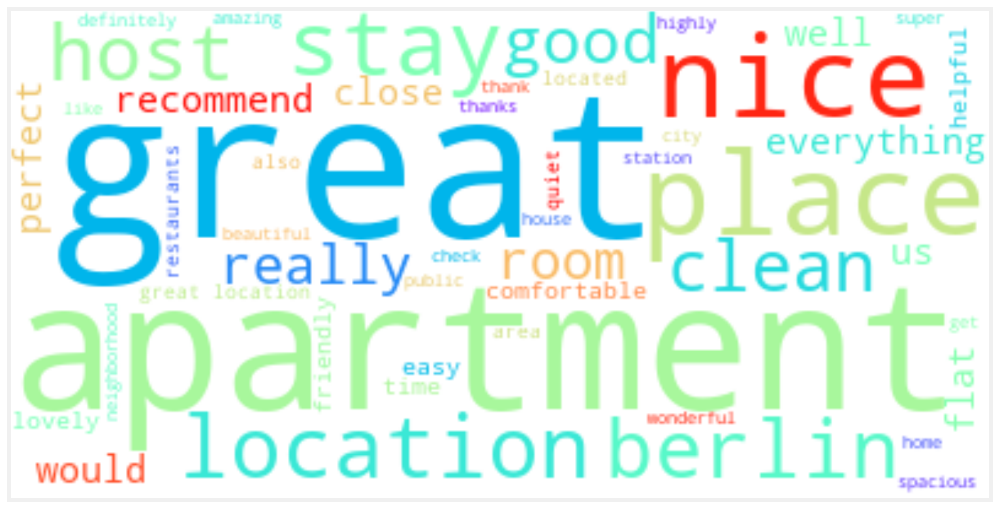

In [45]:
wc_gen = {}
wc = WordCloud(mode='RGBA',background_color='white',colormap='rainbow',random_state=2)

fig, ax = plt.subplots(figsize=(12,40))


wc_gen = wc.generate_from_frequencies(dict(c.reset_index().values))
ax.imshow(wc_gen,interpolation='bilinear')
ax.set_xticks([])
ax.set_yticks([])
    
plt.show()

In [56]:
df_ids=pd.merge(reviews,df,how='left',left_index=True,right_index=True)

In [57]:
df_ids.to_csv('berlin_review_sent_vec_sample')

In [58]:
df_ids_grouped=df_ids.groupby(df_ids.listing_id).agg(np.mean)

In [59]:
df_ids_grouped.vader_compound.iplot(kind='hist', title= 'Total Compound sentiment of a listing', xTitle= 'Vader compound',
                                   yTitle = 'Number of listings')

In [60]:
df_ids_grouped['sent']=df_ids_grouped.vader_compound.map(lambda x: 'pos' if x>= 0.05
                                      else 'neg' if x<= -0.05
                                      else 'neu')

In [61]:
df_ids_grouped.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7306 entries, 2015 to 29525592
Columns: 10008 entries, listing_id to zoologischer garten
dtypes: float64(10007), object(1)
memory usage: 557.9+ MB


In [62]:
df_ids_grouped.to_csv('berlin_review_grouped_sent_vec_sample')